# Tracking synapses


In [2]:
import time

from caveclient import CAVEclient
from paleo import (
    get_initial_graph,
    get_root_level2_edits,
    get_nucleus_supervoxel,
    get_node_aliases,
)

In [3]:
root_id = 864691135639556411
client = CAVEclient("minnie65_public", version=1078)

## Collect edit history information


In [4]:
edits = get_root_level2_edits(root_id, client)
initial_graph = get_initial_graph(root_id, client)
nuc_supervoxel_id = get_nucleus_supervoxel(root_id, client)
node_info = get_node_aliases(nuc_supervoxel_id, client, stop_layer=2)
anchor_nodes = node_info.index

Extracting level2 edits:   0%|          | 0/693 [00:00<?, ?it/s]

/Users/ben.pedigo/code/cave-edits/paleo/.venv/lib/python3.12/site-packages/networkx/readwrite/json_graph/node_link.py:287: FutureWarning: 
The default value will be changed to `edges="edges" in NetworkX 3.6.

To make this warning go away, explicitly set the edges kwarg, e.g.:

  nx.node_link_graph(data, edges="links") to preserve current behavior, or
  nx.node_link_graph(data, edges="edges") for forward compatibility.
  warnings.warn(


Getting initial graph:   0%|          | 0/309 [00:00<?, ?it/s]

## Apply edit history


In [5]:
from paleo import apply_edit_sequence

components = apply_edit_sequence(
    initial_graph,
    edits,
    anchor_nodes,
    return_graphs=False,
    include_initial=True,
    verbose=True,
)
components

  0%|          | 0/694 [00:00<?, ?it/s]

{-1: {161373192110212021,
  161373192177319957,
  161373260829688894,
  161373260896796674,
  161373329549165526,
  161373329616273411,
  161373398335750279,
  161443492202020923,
  161443560854389734,
  161443560921497602,
  161443629573866365,
  161443629640974337,
  161443698293343195,
  161443698360451073,
  161443767079927917,
  161513860946198532,
  161513929598567394,
  161513929665675266,
  161513929665675274,
  161513998318044173,
  161513998385152001,
  161514067037520900,
  161514067104628737,
  161514135824105588,
  161514135824105609,
  161584229690376221,
  161584298342745132,
  161584298409852931,
  161584367062221750,
  161584367129329665,
  161584435781698483,
  161584435848806401,
  161584435848806430,
  161654598434553982,
  161654667154030620,
  161654735806399337,
  161654735873507331,
  161654804592984109},
 9028: {161373192110212021,
  161373192177319957,
  161373260829688894,
  161373260896796674,
  161373329549165526,
  161373329616273411,
  161373398335750279,

## Get synapses, map to state history


In [6]:
from paleo import get_mutable_synapses

currtime = time.time()

pre_synapses = get_mutable_synapses(
    root_id, edits, client, verbose=True, sides="pre"
)

print(f"{time.time() - currtime:.3f} seconds elapsed.")

/Users/ben.pedigo/code/cave-edits/paleo/.venv/lib/python3.12/site-packages/networkx/readwrite/json_graph/node_link.py:287: FutureWarning: 
The default value will be changed to `edges="edges" in NetworkX 3.6.

To make this warning go away, explicitly set the edges kwarg, e.g.:

  nx.node_link_graph(data, edges="links") to preserve current behavior, or
  nx.node_link_graph(data, edges="edges") for forward compatibility.
  warnings.warn(


Getting original roots took 1.29 seconds
Getting latest roots took 4.12 seconds
Querying synapse table for pre-synapses...
Querying synapse table took 30.24 seconds


Getting leaves:   0%|          | 0/3046 [00:00<?, ?it/s]

Getting remaining level2s:   0%|          | 0/6 [00:00<?, ?it/s]

107.186 seconds elapsed.


In [13]:
from paleo import map_synapses_to_sequence

pre_synapses_by_state = map_synapses_to_sequence(pre_synapses, components, side="pre")

  0%|          | 0/694 [00:00<?, ?it/s]

In [14]:
pre_synapses_by_state

{-1: [],
 9028: [],
 14768: [],
 25672: [],
 26481: [],
 30000: [],
 31715: [],
 38740: [],
 39371: [],
 48560: [],
 49452: [],
 72811: [],
 74531: [161850858,
  189432137,
  185549118,
  189955131,
  185551198,
  189955192,
  173214806,
  175121335,
  175121197,
  189954862,
  189954842,
  161470811,
  189432488,
  189432294,
  189432341,
  156938288,
  161469398,
  189432102,
  175120892,
  178846653],
 75068: [161850858,
  189432137,
  185549118,
  189955131,
  185551198,
  189955192,
  173214806,
  175121335,
  175121197,
  189954862,
  189954842,
  161470811,
  189432488,
  189432294,
  189432341,
  156938288,
  161469398,
  189432102,
  175120892,
  178846653],
 75928: [161850858,
  189432137,
  185549118,
  189955131,
  185551198,
  189955192,
  173214806,
  175121335,
  175121197,
  189954862,
  189954842,
  161470811,
  189432488,
  189432294,
  189432341,
  156938288,
  161469398,
  189432102,
  175120892,
  178846653],
 79268: [161850858,
  189432137,
  185549118,
  18995513

## Plot number of synapses over time


In [17]:
n_synapses = [len(s) for s in pre_synapses_by_state.values()]

Text(0, 0.5, 'Number of pre-synapses')

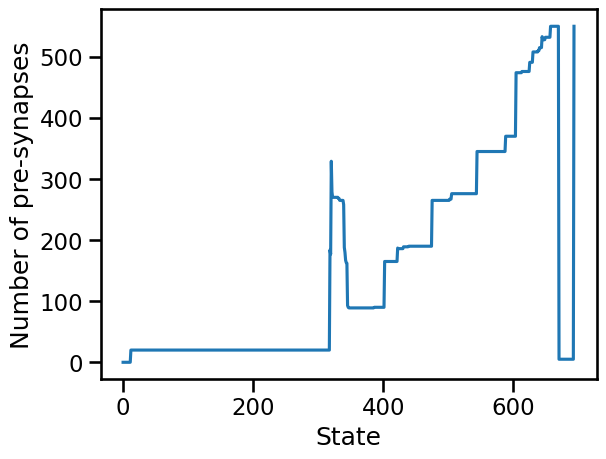

In [18]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.set_context("talk")

fig, ax = plt.subplots()
sns.lineplot(x=range(len(n_synapses)), y=n_synapses, ax=ax)
ax.set_xlabel("State")
ax.set_ylabel("Number of pre-synapses")